# Information for groups working on projects 7 (Future Arctic sea ice) and 8 (the Atlantic Multidecadal Oscillation)

The aim of this notebook is to give you some information that might be useful for starting your projects: 

- Part A provides you with a quick introduction to the CMIP6 project and ensemble modelling. It also contains a list of links that provide details about the data that are available to you in the CMIP6 catalogue. You can use this to help you to decide what data you want to analyse for your project.
- Part B provides some examples of how to plot data on maps easily, by combining xarray (which you saw in Guillaume's Pangeo session last week) with Cartopy

## A. Data sources and information about CMIP6

### 1. Introduction
Projects 7 & 8 require you to analyse model output from the CMIP6 project. It is possible to access these data a number of ways, including via the cloud, since Google host a part of these data via their Public Datasets programme (https://cloud.google.com/blog/products/data-analytics/new-climate-model-data-now-google-public-datasets). For your projects, this is how you will access the CMIP6 data. As you saw last week in class, this method means that you will be able to analyse the data directly in Colab without downloading anything to your machine.

### 2. What is ensemble modelling and why do we do it?
CMIP6 uses an ensemble modelling strategy. What does this mean?

In the context of CMIP6, an ensemble of model simulations is simply a collection of simulations that have been created using exactly the same configuration for everything, with the exception of the initial conditions. These small differences in the initial state can lead to much larger differences in the forecast over time, as popularised in the so-called "butterfly effect".

We use ensemble modelling to help us understand the probability of the events simulated by the model occurring. For example, imagine that we use an ensemble of 5 simulations to try to forecast next week's weather, and all 5 simulations predict that it will rain in Brest. In this case, we will be more likely to believe that it will rain next week than if our results had been that 2 of our simulations told us that it would rain, 2 told us that it would be sunny and 1 told us that it would snow.

The aim of the ensemble approach in climate modelling (as in CMIP6) is the same as in the weather forecasting case: it is an attempt to quantify how much we believe the predictions of the future climate.

### 3. What is CMIP6?
CMIP = Coupled Model Intercomparison Project (wikipedia page: https://en.wikipedia.org/wiki/Coupled_Model_Intercomparison_Project)

The CMIP programme aims to improve our knowledge of climate change. It began in 1995, and has already been through 5 "phases". Each "phase" corresponds to a coordinated effort to collect together a number of climate simulations created by research centres around the world. These simulations are then made freely available for anybody to download and analyse. Phase 6 is now underway: the data that you will be analysing are thus only recently available, and are likely to be used in research studies for about the next ten years or so.

A number of experiments are defined at each phase. These often consist of "historical" experiments, which simulate the climate over the past decade, and a number of future experiments, which simulate the future climate in response to certain prescribed greenhouse gas concentration scenarios, which should represent the response to possible future decisions made by society. (If you are interested in reading more about these, this article provides a nice introduction: https://www.carbonbrief.org/explainer-how-shared-socioeconomic-pathways-explore-future-climate-change)

### 4. What data are available for your projects?
The CMIP6 catalogue contains a lot of data: the entire archive may eventually comprise 20PB of data when all the simulations have been completed! Not all of this data is available yet, and not all available data is stored in the Cloud, so you will need to check to see what is available when deciding which model(s) and scenario(s) you want to analyse.

The people at Pangeo have written some useful summaries that describe:

- the data available in the Cloud: https://docs.google.com/document/d/1yUx6jr9EdedCOLd--CPdTfGDwEwzPpCF6p1jRmqx-0Q/edit
- a list of the models available: https://docs.google.com/spreadsheets/d/13DHeTEH_8G08vxTMX1Fs-WbAA6SamBjDdh0fextdcGE/edit#gid=165882553
- a list of the variables available: https://docs.google.com/spreadsheets/d/1UUtoz6Ofyjlpx5LdqhKcwHFz2SGoTQV2_yekHyMfL9Y/edit#gid=1221485271

They have also produced an example notebook that shows how to load in air temperature. You can either run it via Binder on the Pangeo infrastructure: https://binder.pangeo.io/v2/gh/pangeo-data/pangeo-cmip6-examples/master or run it directly in Colab: https://colab.research.google.com/drive/19iEVxE_9QoTeg4st7MmucHJUmO93NXHp

Their notebook is an excellent introduction: it should provide you with everything that you need to get started loading the data. I recommend that you look at it!

## B. Using xarray with Cartopy

Last week we talked a lot about accessing and analysing data, but we didn't talk much about how to make figures. In the geosciences, often we want to make maps. Unfortunately, sometimes this can be more difficult than we would like! Model grids are often irregular, and it can be difficult to plot data in the polar regions, where all longitudes get closer and closer together, and finally converge to a single point.

The Pangeo notebook shows an example of loading CMIP6 data using xarray. One of the really nice features of xarray is that it integrates with the plotting library Cartopy (https://scitools.org.uk/cartopy/docs/latest/) to enable us to change map projections and easily transform our data. We'll look at an example for the Arctic below.

Let's load in the sea surface height for the IPSL model in the Shared Socioeconomic Pathway 2 scenario:

In [ ]:
# first we have to install some libraries in Colab
!pip install xarray[complete]
!pip install zarr
!pip install gcsfs
!apt-get -qq install python-cartopy python3-cartopy;
!pip uninstall -y shapely;    # cartopy and shapely don't work well together at the moment
!pip install shapely --no-binary shapely; # so reinstall a version that will work

Found existing installation: Shapely 1.8.0
Uninstalling Shapely-1.8.0:
  Successfully uninstalled Shapely-1.8.0
  Using cached Shapely-1.8.0.tar.gz (278 kB)
Skipping wheel build for shapely, due to binaries being disabled for it.
    Running setup.py install for shapely ... done
ERROR: pip's dependency resolver does not currently take into account all the packages that are installed. This behaviour is the source of the following dependency conflicts.
albumentations 0.1.12 requires imgaug<0.2.7,>=0.2.5, but you have imgaug 0.2.9 which is incompatible.


In [ ]:
# set up our libraries
from matplotlib import pyplot as plt
import numpy as np
import pandas as pd
import xarray as xr
import zarr
import gcsfs
import datetime
from matplotlib.dates import drange

!pip install seawater
!pip install cartopy==0.18
import seawater as sw

# set up cartopy
import cartopy.crs as ccrs
from matplotlib.axes import Axes
from cartopy.mpl.geoaxes import GeoAxes
GeoAxes._pcolormesh_patched = Axes.pcolormesh

# notebook display options
xr.set_options(display_style='html')
%matplotlib inline
%config InlineBackend.figure_format = 'retina'

/usr/local/lib/python3.7/dist-packages/xarray/backends/cfgrib_.py:28: UserWarning: Failed to load cfgrib - most likely there is a problem accessing the ecCodes library. Try `import cfgrib` to get the full error message
  "Failed to load cfgrib - most likely there is a problem accessing the ecCodes library. "


In [ ]:
## Est-ce que les modèles representent bien la diminution de la glace de mer
## Moyenne selon régions
## Diminution locales comparées
## Différence entre expériences
## Lien avec les autres variables

In [ ]:
def load_data(df, activity_id, table_id, variable_id, experiment_id, institution_id = "None"):
  if (institution_id == 'None'):
    strin = "activity_id== \'"+activity_id+"\' & table_id == \'" + table_id + "\' & variable_id == \'" + variable_id + "\' & experiment_id == \'" + experiment_id + "\'"
  else:
    strin = "activity_id== \'"+activity_id+"\' & table_id == \'" + table_id + "\' & variable_id == \'" + variable_id + "\' & experiment_id == \'" + experiment_id + "\' & institution_id == \'" + institution_id + "\'"
  return df.query(strin)

activity_id = 'ScenarioMIP' # CMIP catalogue
institution_id = 'IPSL' # ID de l'institution de l'expérience (ici 'IPSL', institution Pierre Simon Laplace)
experiment_id = 'ssp585' # Voir (1): 'ssp245' (Scenario du GIEC)
table_id = 'Omon' # Voir (1) : 'Omon' (Data taken monthly)
variable_id = 'siextentn' # Voir (3) :  'zos' (Sea surface Height above geoide), 'siextentn' (Sea Ice extent north), 'siarean' (Sea Ice Area (km2))
## grid_label : gn: grille normale, gr: nouvelle grille, gm: pas de grille

# <mip_era>/
#      <activity_id>/
#          <institution_id>/
#              <source_id>/
#                  <experiment_id>/
#                      <member_id>/
#                          <table_id>/
#                              <variable_id>/
#                                  <grid_label>/
#                                      <version>/
#                                        <CMOR filename>.nc

# and load in the SSH data
df = pd.read_csv('https://storage.googleapis.com/cmip6/cmip6-zarr-consolidated-stores.csv')
#df_ssh = df.query("activity_id=='ScenarioMIP' & table_id == 'Omon' & variable_id == 'zos' & experiment_id == 'ssp245' & institution_id == 'IPSL'")
df_ssh = load_data(df, activity_id, table_id, variable_id, experiment_id, institution_id = 'IPSL')

# setup the gcs access
gcs = gcsfs.GCSFileSystem(token='anon')

# get the path to a specific zarr store (the first one from the dataframe above)
#zstore = df_ssh.zstore.values[-1]

/usr/local/lib/python3.7/dist-packages/xarray/backends/plugins.py:61: RuntimeWarning: Engine 'cfgrib' loading failed:
Cannot find the ecCodes library
  warnings.warn(f"Engine {name!r} loading failed:\n{ex}", RuntimeWarning)


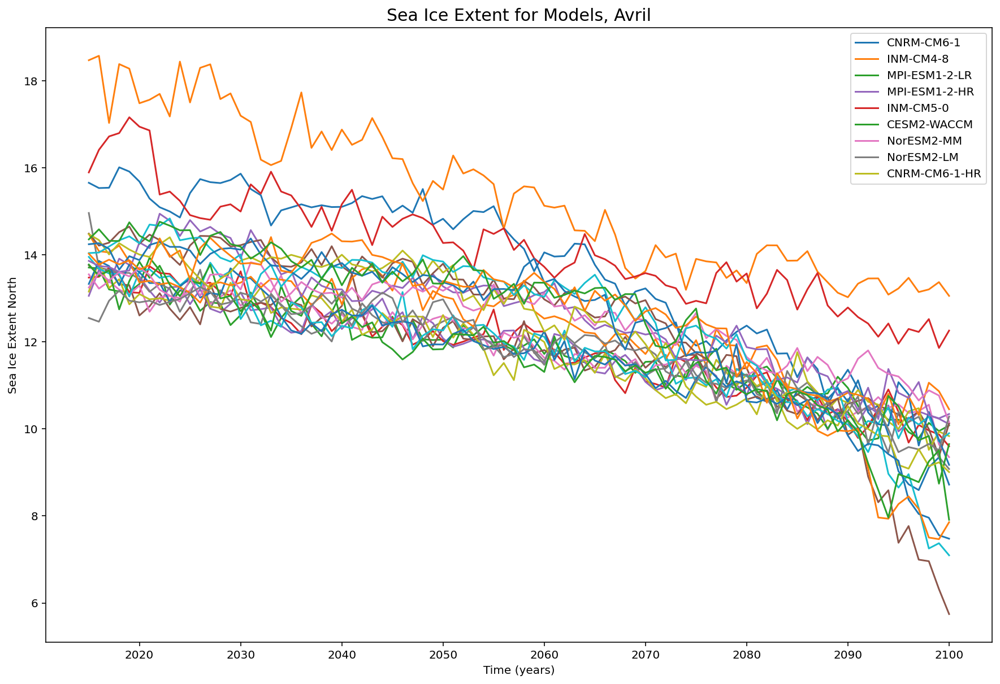

In [ ]:
# create a mapping interface to the store
historical = df[(df["experiment_id"]=="historical")  & (df["variable_id"]=="siextentn")]# (df["version"] ==np.max(df[(df["experiment_id"]=="historical")  & (df["variable_id"]=="siextentn")].version))]

sea_ice_extent_north = df[(df["experiment_id"]=="ssp585") & (df["variable_id"]=="siextentn")]

###### Variables
month = 4

###### Code
months = ['Janvier', 'Fevrier', 'Mars', 'Avril', 'Mai', 'Juin', 'Juillet', 'Aout', 'Septembre', 'Octobre', 'Novembre', 'Decembre']
time_month = np.arange(2015, 2101, 1/12)
time_year = np.arange(2015, 2101)
time_year2 = np.arange(1850, 2101)


###### Dates
date1 = datetime.datetime(2015, 1, 1)
date2 = datetime.datetime(2101, 1, 1)
delta = datetime.timedelta(hours = 8766)
dates = drange(date1, date2, delta)

##### Plot
plt.figure(figsize = (15, 10))
for i, row in sea_ice_extent_north.iterrows():
  mapper = gcs.get_mapper(row.zstore)
  ds = xr.open_zarr(mapper, consolidated=True,decode_times=True)
  #if 'nav_lon' in ds.siextentn.coords:
  #  serie = ds.siextentn.sum()
  #else:
  #  serie = ds.siextentn

  if (np.shape(ds.siextentn) == (1032,)):
    plt.plot_date(dates, ds.siextentn[month-1::12], '-',label = ds.source_id) ## Depart le 1er janvier 2015


handles, labels = plt.gca().get_legend_handles_labels()
by_label = dict(zip(labels, handles))
plt.legend(by_label.values(), by_label.keys())
plt.xlabel('Time (years)')
plt.ylabel('Sea Ice Extent North')
plt.title("Sea Ice Extent for Models, " + months[month-1], fontsize=15);
#plt.xlim(datetime([2015, 2101],[1, 1],[1, 1]))
#plt.xtickformat('dd-MMM-yyyy')

In [ ]:
print(historical.columns)
print(np.max(historical.version))

Index(['activity_id', 'institution_id', 'source_id', 'experiment_id',
       'member_id', 'table_id', 'variable_id', 'grid_label', 'zstore',
       'dcpp_init_year', 'version'],
      dtype='object')
20200226


In [ ]:
plt.figure(figsize=(20,10))
for i, row in historical.iterrows():
    mapper = gcs.get_mapper(row.zstore)
    ds = xr.open_zarr(mapper, consolidated=True,decode_times=False)
    #print(np.shape(ds.siextentn))
    if (np.shape(ds.siextentn) == (1980,)):
      plt.plot(ds.siextentn[::12], label = ds.source_id, alpha = 0.6)
    elif (np.shape(ds.siextentn) == (1980,1,1)):
      plt.plot(ds.siextentn[::12,0,0], label = ds.source_id, alpha = 0.6)


In [ ]:


series = {}

for i, row in sea_ice_extent_north.iterrows():
    mapper = gcs.get_mapper(row.zstore)
    ds = xr.open_zarr(mapper, consolidated=True,decode_times=False)
    serie = ds.siextentn
    #serie = hours_to_date(serie, stop=753121)
    if ds.source_id not in series: 
      series[ds.source_id] = {}
      #print(ds.source_id)
    if ds.experiment_id not in series[ds.source_id]: 
      series[ds.source_id][ds.experiment_id] = {}
      #print(ds.experiment_id)
    series[ds.source_id][ds.experiment_id][ds.attrs["variant_label"]] = serie

for i, row in historical.iterrows():
    mapper = gcs.get_mapper(row.zstore)
    ds = xr.open_zarr(mapper, consolidated=True,decode_times=False)
    serie = ds.siextentn
    #serie = hours_to_date(serie, stop=753121)
    if ds.source_id not in series: 
      series[ds.source_id] = {}
      #print(ds.source_id)
    if ds.experiment_id not in series[ds.source_id]: 
      series[ds.source_id][ds.experiment_id] = {}
      #print(ds.experiment_id)
    series[ds.source_id][ds.experiment_id][ds.attrs["variant_label"]] = serie

for source in series.keys(): 
  print(series[source].keys())

for source in series.keys():
  for member_id in series[source]['historical'].keys():
    if "ssp585" in series[source]:
      if (member_id in series[source]["ssp585"]):
        None
        #print(series[source]["ssp585"][member_id])
      #print(source, member_id, member_id in series[source]["ssp585"])

dict_keys(['ssp585', 'historical'])
dict_keys(['ssp585', 'historical'])
dict_keys(['ssp585', 'historical'])
dict_keys(['ssp585', 'historical'])
dict_keys(['ssp585', 'historical'])
dict_keys(['ssp585', 'historical'])
dict_keys(['ssp585', 'historical'])
dict_keys(['ssp585', 'historical'])
dict_keys(['ssp585', 'historical'])
dict_keys(['ssp585', 'historical'])
dict_keys(['ssp585', 'historical'])
dict_keys(['historical'])
dict_keys(['historical'])
dict_keys(['historical'])
dict_keys(['historical'])
dict_keys(['historical'])
dict_keys(['historical'])


Nombre de courbes historiques totales :  24


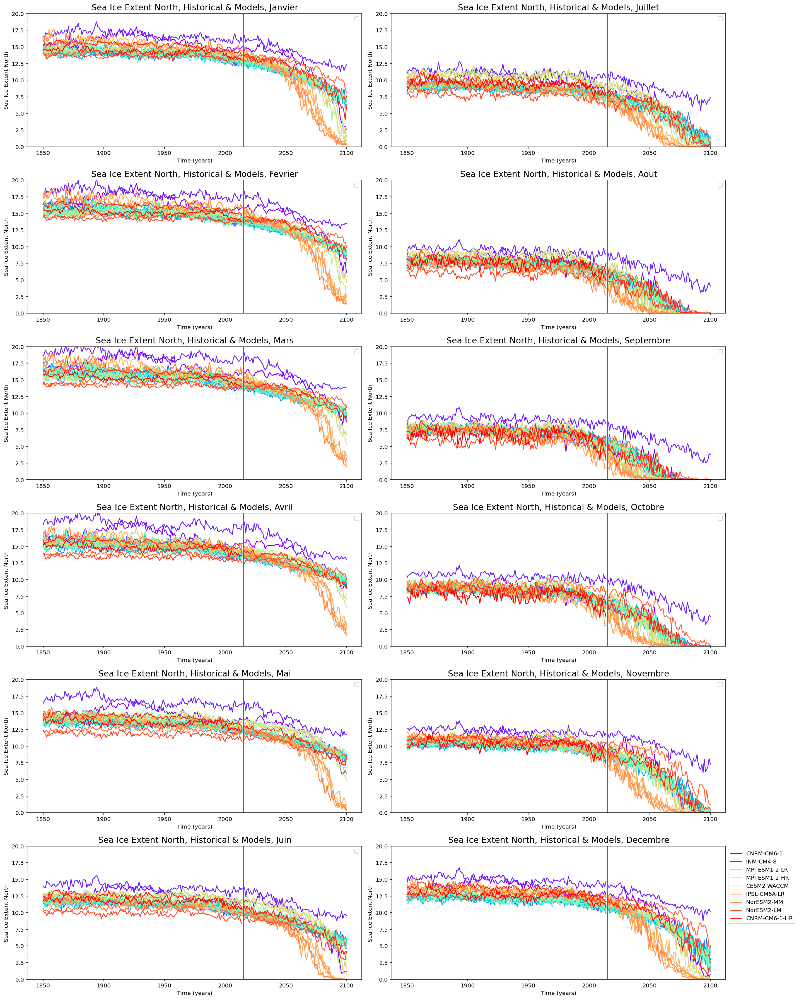

In [ ]:
## Variables
verbose = True
number = 24 ## Pour la colormap, Change à chaque variable (18 siarean, 24 siextentn)
name = 'Sea Ice Extent North'

########## MODELS PLOT
cmap = plt.get_cmap('rainbow')
colors = [cmap(i) for i in np.linspace(0, 1, number)]
fig, ax = plt.subplots(6, 2, figsize = (20, 25))
flag = True
modeles_utilises = []
valeurs_2015 = []
for ii in range(12):
  count = 0
  for source in series.keys(): ## noms d'expériences
    for member_id in series[source]['historical'].keys(): ## id des experiences historiques
      if "ssp585" in series[source].keys(): ## si ssp585 est dans les sources
        if member_id in series[source]["ssp585"].keys():
          plot_ssp = series[source]['ssp585'][member_id]
          plot_hist = series[source]['historical'][member_id]
          if (np.shape(plot_ssp) == (1032,)):
            ax[ii%6, ii//6].plot(time_year2[165:], plot_ssp[ii::12], label =  source, color = colors[count]) ## Depart le 1er janvier 2015
          elif (np.shape(plot_ssp) == (1032,1,1)):
            ax[ii%6, ii//6].plot(time_year2[165:], plot_ssp[ii::12,0,0], label =  source, color = colors[count]) ## Depart le 1er janvier 2015

          if (np.shape(plot_hist) == (1980,)):
            ax[ii%6, ii//6].plot(time_year2[:165], plot_hist[ii::12], color = colors[count])
            modeles_utilises.append(source)
            valeurs_2015.append(series[source]['historical'][member_id][-1])
            count += 1
          elif (np.shape(plot_hist) == (1980,1,1)):
            ax[ii%6, ii//6].plot(time_year2[:165], plot_hist[ii::12,0,0], color = colors[count])
            modeles_utilises.append(source)
            valeurs_2015.append(series[source]['historical'][member_id][-1])
            count += 1
  handles, labels = plt.gca().get_legend_handles_labels()
  by_label = dict(zip(labels, handles))
  ax[ii%6, ii//6].axvline(x=2015)
  ax[ii%6, ii//6].legend(by_label.values(), by_label.keys(), bbox_to_anchor =(1.0, 1.0))
  ax[ii%6, ii//6].set_ylim((0,20))
  ax[ii%6, ii//6].set_xlabel('Time (years)')
  ax[ii%6, ii//6].set_ylabel(name)
  ax[ii%6, ii//6].set_title(name + ", Historical & Models, " + months[ii], fontsize=15);
fig.tight_layout()
if verbose:
  print("Nombre de courbes historiques totales : ", count) ## Le nombre à mettre à number

## Part 2/ Geographic Studies

In [ ]:
from matplotlib import animation, rc

activity_id = 'ScenarioMIP' # CMIP catalogue
institution_id = 'IPSL' # ID de l'institution de l'expérience (ici 'IPSL', institution Pierre Simon Laplace)
experiment_id = 'ssp585' # Voir (1): 'ssp245' (Scenario du GIEC)
table_id = 'Omon' # Voir (1) : 'Omon' (Data taken monthly)
variable_id = 'siextentn' # Voir (3) :  'zos' (Sea surface Height above geoide), 'siextentn' (Sea Ice extent north), 'siarean' (Sea Ice Area (km2))

df = pd.read_csv('https://storage.googleapis.com/cmip6/cmip6-zarr-consolidated-stores.csv')
#df2 = load_data(df, activity_id, table_id, variable_id, experiment_id, institution_id = 'IPSL')

#var = 'siextentn'
#var = 'sithick'
var = 'sisnconc'

experiment = df[(df["experiment_id"]=="ssp585") & (df["variable_id"]==var)]
historical = df[(df["experiment_id"]=="historical")  & (df["variable_id"]==var)]

In [ ]:
# si ça bugue, redémarrer l'environnement

series_map = {}

for i, row in experiment.iterrows():
    mapper = gcs.get_mapper(row.zstore)
    ds = xr.open_zarr(mapper, consolidated=True,decode_times=True)
    # serie = ds.siextentn ########################################
    serie = ds.sisnconc
    #serie = ds.sithick

    if ds.source_id not in series_map: 
      series_map[ds.source_id] = {}
    if ds.experiment_id not in series_map[ds.source_id]: 
      series_map[ds.source_id][ds.experiment_id] = {}
    series_map[ds.source_id][ds.experiment_id][ds.attrs["variant_label"]] = serie

for i, row in historical.iterrows():
    mapper = gcs.get_mapper(row.zstore)
    ds = xr.open_zarr(mapper, consolidated=True,decode_times=True)
    # serie = ds.siextentn ########################################
    serie = ds.sisnconc
    #serie = ds.sithick

    if ds.source_id not in series_map: 
      series_map[ds.source_id] = {}
    if ds.experiment_id not in series_map[ds.source_id]: 
      series_map[ds.source_id][ds.experiment_id] = {}
    series_map[ds.source_id][ds.experiment_id][ds.attrs["variant_label"]] = serie

for source in series_map.keys(): 
  print(series_map[source].keys())


/usr/local/lib/python3.7/dist-packages/xarray/coding/times.py:527: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates out of range
  dtype = _decode_cf_datetime_dtype(data, units, calendar, self.use_cftime)
/usr/local/lib/python3.7/dist-packages/xarray/coding/times.py:527: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates out of range
  dtype = _decode_cf_datetime_dtype(data, units, calendar, self.use_cftime)
/usr/local/lib/python3.7/dist-packages/numpy/core/_asarray.py:83: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates out of range
  return array(a, dtype, copy=False, order=order)
/usr/local/lib/python3.7/dist-packages/xarray/coding/times.py:527: SerializationWarning: Unable to decode time a

dict_keys(['ssp585', 'historical'])
dict_keys(['ssp585', 'historical'])
dict_keys(['ssp585', 'historical'])
dict_keys(['ssp585', 'historical'])
dict_keys(['ssp585', 'historical'])
dict_keys(['ssp585', 'historical'])
dict_keys(['ssp585', 'historical'])
dict_keys(['ssp585', 'historical'])
dict_keys(['ssp585', 'historical'])
dict_keys(['ssp585', 'historical'])
dict_keys(['ssp585', 'historical'])
dict_keys(['ssp585', 'historical'])
dict_keys(['ssp585', 'historical'])
dict_keys(['ssp585', 'historical'])
dict_keys(['ssp585', 'historical'])
dict_keys(['ssp585', 'historical'])
dict_keys(['ssp585', 'historical'])
dict_keys(['ssp585', 'historical'])
dict_keys(['ssp585', 'historical'])
dict_keys(['ssp585', 'historical'])
dict_keys(['ssp585', 'historical'])
dict_keys(['ssp585', 'historical'])
dict_keys(['ssp585', 'historical'])
dict_keys(['ssp585', 'historical'])
dict_keys(['historical'])
dict_keys(['historical'])
dict_keys(['historical'])
dict_keys(['historical'])
dict_keys(['historical'])
dict_k

In [ ]:
def plot_map(ds, new_fig = True, extend = [-180, 180, 55, 90], figsize = (20, 20), xx = 'longitude', yy = 'latitude'):
  '''Plot la figure ds à l'aide de pcolormesh, extension arctique'''
  if new_fig:
    fig = plt.figure(figsize = figsize)
  ax = plt.axes(projection=ccrs.NorthPolarStereo())
  ax.set_extent(extend, ccrs.PlateCarree())
  ds.plot.pcolormesh(ax=ax,transform=ccrs.PlateCarree(),x=xx, y=yy, add_colorbar=True); 
  ax.coastlines()

def animat(ds, extend = [-180, 180, 55, 90], figsize = (15, 15), xx = 'longitude', yy = 'latitude', step = 60, start_month=0, title = 'None', histo = True, source = 'None'):
  '''Animation de la figure ds, extension arctique.
  -> ds la data à afficher
  -> extend les bords de la map
  -> figsize la taille de figure
  -> xx et yy les noms appropriés de latitude et longitude
  -> step : On ne prend qu'une donnée sur step. Doit être divisible par 12 si on prend par mois
  -> start_month : mois de départ, Janvier = 0
  -> title : Médiane de l'ensemble des codes nucléaires de l'état français. Si mdp oublié, veuillez contacter immédiatement le président.
  -> histo : historique ou pas ???'''
  months = ['Janvier', 'Fevrier', 'Mars', 'Avril', 'Mai', 'Juin', 'Juillet', 'Aout', 'Septembre', 'Octobre', 'Novembre', 'Decembre']
  fig = plt.figure(figsize = figsize)
  ax = plt.axes(projection=ccrs.NorthPolarStereo())
  ax.set_extent(extend, ccrs.PlateCarree())
  ax.coastlines()
  if (title != 'None'):
    ax.set_title(title)
  if (histo !=1):
    start_year = 1850
  else:
    start_year = 2015
  img = []
  for i in range(np.shape(ds)[0]//step):
      year_actual = start_year + int(i * step/12)
      if (year_actual>=2015):
        typeplot = 'Model'
      else:
        typeplot = 'Historical'
      if (source != 'None'):
        typeplot = typeplot + ' ,' + source
      aa = ds[start_month + i*step].plot.pcolormesh(ax=ax,transform=ccrs.PlateCarree(),cmap = 'Blues', x=xx, y=yy)
      title2 = ax.text(0.5,1.05,title + ", " + typeplot + ", " + months[start_month] + " {}".format(year_actual), 
                    size=plt.rcParams["axes.titlesize"],
                    ha="center", fontsize = 15, transform=ax.transAxes, )

      img.append([aa, title2])
      if(i!=np.shape(ds)[0]//step-1):
        cb = ax.collections[-1].colorbar
        cb.remove()
  ani = animation.ArtistAnimation(fig, img, blit=True,repeat_delay=0)
  plt.close()
  rc('animation', html='jshtml')
  return(ani)


def verbosing(booly, source = None, exp = None,count = None, ssp = None, hist = None, error = None):
  '''Fonction verbose. Ne fonctionne pas pour le moment'''
  if booly:
    print('--------------------------------------')
    if (source != None):
      print('Source : ', source)
    if (exp != None):
      print('Experiment : ', exp)
    if (count != None):
      print('Nb Experiments : ', count)
    if (ssp != None):
      print('SSP shape : ', np.shape(ssp))
    if (hist != None):
      print('Historical shape : ', np.shape(hist))
    if (error != None):
      print('Pourcentage d\'erreurs de dimensions : ' + error + ' %')



In [ ]:
verbose1 = False
verbose2 = True

###
flag = True
count2 = 0
sspfin_tab = []
histfin_tab = []
sources_tab = []
for ii in range(12): ## Pour chaque mois
  for source in series_map.keys(): ## noms d'expériences
    for member_id in series_map[source]['historical'].keys(): ## id des experiences historiques
      if "ssp585" in series_map[source].keys(): ## si ssp585 est dans les sources
        if member_id in series_map[source]["ssp585"].keys(): ## Si le member id de historical est aussi dans ssp
          plot_ssp = series_map[source]['ssp585'][member_id]
          plot_hist = series_map[source]['historical'][member_id]
          if verbose1:
            print('--------------------------------------')
            print('Source : ', source)
            print('Experiment : ', member_id)
            print('SSP shape : ', np.shape(plot_ssp))
            print('Historical shape : ', np.shape(plot_hist))

          if flag:
            sspfin = plot_ssp
            histfin = plot_hist
            count = 1
            flag = False
            #if (np.shape(plot_ssp) == (1032, 300, 360)):
              #ssp_chosed = plot_ssp
              #hist_chosed = plot_hist
              #count+=1
              #if verbose:
              #  print('--> Plotted.');
          else:
            if (source == previous_source):
              if (np.shape(plot_ssp) != np.shape(sspfin)):
                count2 +=1
                if verbose1:
                  print('ERROR : N\'a pas la même forme pour la ' + str(count2) + ' fois sur cette source.')
              else:
                sspfin = sspfin + plot_ssp
                histfin = histfin + plot_hist
                count +=1
            else:
              flag = True
              sspfin_tab.append(sspfin/count)
              histfin_tab.append(histfin/count)
              sources_tab.append(previous_source)

              if verbose2:
                print('--------------------------------------')
                print('Source : ', source)
                print('Nb Experiments : ', count)
                print('SSP shape : ', np.shape(sspfin))
                print('Historical shape : ', np.shape(histfin))
                print('Pourcentage d\'erreurs de dimensions : ' + str(100 * count2/(count+count2)) + ' %')

              count2 = 0
              
          previous_source = source

 
sspfin_tab.append(sspfin/count)
histfin_tab.append(histfin/count)
sources_tab.append(source)
if verbose2:
  print('--------------------------------------')
  print('Source : ', source)
  print('Nb Experiments : ', count)
  print('SSP shape : ', np.shape(sspfin))
  print('Historical shape : ', np.shape(histfin))
  print('Pourcentage d\'erreurs de dimensions : ' + str(100 * count2/(count+count2)) + ' %')


--------------------------------------
Source :  GFDL-CM4
Nb Experiments :  1
SSP shape :  (1032, 180, 360)
Historical shape :  (1980, 576, 720)
Pourcentage d'erreurs de dimensions : 0.0 %
--------------------------------------
Source :  CNRM-CM6-1
Nb Experiments :  1
SSP shape :  (1032, 830305)
Historical shape :  (1980, 830305)
Pourcentage d'erreurs de dimensions : 0.0 %
--------------------------------------
Source :  CanESM5-CanOE
Nb Experiments :  49
SSP shape :  (1032, 291, 360)
Historical shape :  (1980, 291, 360)
Pourcentage d'erreurs de dimensions : 2.0 %
--------------------------------------
Source :  UKESM1-0-LL
Nb Experiments :  2
SSP shape :  (1032, 291, 360)
Historical shape :  (1980, 291, 360)
Pourcentage d'erreurs de dimensions : 0.0 %
--------------------------------------
Source :  MPI-ESM1-2-LR
Nb Experiments :  4
SSP shape :  (1032, 330, 360)
Historical shape :  (1980, 330, 360)
Pourcentage d'erreurs de dimensions : 0.0 %
--------------------------------------
Sour

In [ ]:
## Variables
choice_source = 6 ## numero de la source choisie. Seuls trois sources possèdent des données consistantes entre les 3 variables utilisées sur ce notebook : 
# 1 (CNRM-CM6-1), 4/5 (MPI-ESM1-2-LR) et 5/6 (MPI-ESM1-2-HR). Or CNRM-CM6-1 et MPI-ESM1-2-LR ont des dimensions difficiles, donc on regardera MPI-ESM1-2-HR
# Sinon, choice_source = 0 fonctionne toujours, même si elle a littéralement été prise au hasard

step = 60 ## step (proportionnel à 12 pour avoir les mois, crash en dessous de 60 (60 non inclus))
start_month = 3 ## Mois à observer (Janvier = 0)
# title = 'Sea Ice Thickness'
title = 'Sea Ice Concentration'
histo = 2 ## historical, ssf or both (! both usually don't work !)

##
lat = 'latitude'
lon = 'longitude' # A changer en cas de "ValueError: x must be one of..."

##
if (histo==0):
  data_chosed = histfin_tab[choice_source]
elif(histo==1):
  data_chosed = sspfin_tab[choice_source]
else:
  if (np.shape(histfin_tab[choice_source][0]) == np.shape(sspfin_tab[choice_source][0])):
    data_chosed = xr.concat((histfin_tab[choice_source], sspfin_tab[choice_source]), dim = 'time')
  else:
    print('ERROR IN CONCATENATE : DIFFERENTS DIMENSIONS')

##
ani_conc_total_avril = animat(data_chosed, source = sources_tab[choice_source], xx = lon, yy = lat, step = step, start_month = start_month, title = title, histo = histo)

/usr/local/lib/python3.7/dist-packages/cartopy/crs.py:245: ShapelyDeprecationWarning: __len__ for multi-part geometries is deprecated and will be removed in Shapely 2.0. Check the length of the `geoms` property instead to get the  number of parts of a multi-part geometry.
  if len(multi_line_string) > 1:
/usr/local/lib/python3.7/dist-packages/cartopy/crs.py:297: ShapelyDeprecationWarning: Iteration over multi-part geometries is deprecated and will be removed in Shapely 2.0. Use the `geoms` property to access the constituent parts of a multi-part geometry.
  for line in multi_line_string:
/usr/local/lib/python3.7/dist-packages/cartopy/crs.py:364: ShapelyDeprecationWarning: __len__ for multi-part geometries is deprecated and will be removed in Shapely 2.0. Check the length of the `geoms` property instead to get the  number of parts of a multi-part geometry.
  if len(p_mline) > 0:
/usr/local/lib/python3.7/dist-packages/cartopy/crs.py:402: ShapelyDeprecationWarning: Iteration over multi-pa

In [ ]:
ani_conc_total_janvier

/usr/local/lib/python3.7/dist-packages/cartopy/crs.py:245: ShapelyDeprecationWarning: __len__ for multi-part geometries is deprecated and will be removed in Shapely 2.0. Check the length of the `geoms` property instead to get the  number of parts of a multi-part geometry.
  if len(multi_line_string) > 1:
/usr/local/lib/python3.7/dist-packages/cartopy/crs.py:297: ShapelyDeprecationWarning: Iteration over multi-part geometries is deprecated and will be removed in Shapely 2.0. Use the `geoms` property to access the constituent parts of a multi-part geometry.
  for line in multi_line_string:
/usr/local/lib/python3.7/dist-packages/cartopy/crs.py:364: ShapelyDeprecationWarning: __len__ for multi-part geometries is deprecated and will be removed in Shapely 2.0. Check the length of the `geoms` property instead to get the  number of parts of a multi-part geometry.
  if len(p_mline) > 0:
/usr/local/lib/python3.7/dist-packages/cartopy/crs.py:402: ShapelyDeprecationWarning: Iteration over multi-pa

In [ ]:
ani_thick_total_octobre

/usr/local/lib/python3.7/dist-packages/cartopy/crs.py:245: ShapelyDeprecationWarning: __len__ for multi-part geometries is deprecated and will be removed in Shapely 2.0. Check the length of the `geoms` property instead to get the  number of parts of a multi-part geometry.
  if len(multi_line_string) > 1:
/usr/local/lib/python3.7/dist-packages/cartopy/crs.py:297: ShapelyDeprecationWarning: Iteration over multi-part geometries is deprecated and will be removed in Shapely 2.0. Use the `geoms` property to access the constituent parts of a multi-part geometry.
  for line in multi_line_string:
/usr/local/lib/python3.7/dist-packages/cartopy/crs.py:364: ShapelyDeprecationWarning: __len__ for multi-part geometries is deprecated and will be removed in Shapely 2.0. Check the length of the `geoms` property instead to get the  number of parts of a multi-part geometry.
  if len(p_mline) > 0:
/usr/local/lib/python3.7/dist-packages/cartopy/crs.py:402: ShapelyDeprecationWarning: Iteration over multi-pa

In [ ]:
#ani_conc_total.save('iceconcentration_janvier.mp4')
ani_conc_total.save('iceconc_janvier.mp4')
ani_conc_total_avril.save('iceconc_avril.mp4')
ani_conc_total_octobre.save('iceconc_octobre.mp4')

/usr/local/lib/python3.7/dist-packages/cartopy/crs.py:245: ShapelyDeprecationWarning: __len__ for multi-part geometries is deprecated and will be removed in Shapely 2.0. Check the length of the `geoms` property instead to get the  number of parts of a multi-part geometry.
  if len(multi_line_string) > 1:
/usr/local/lib/python3.7/dist-packages/cartopy/crs.py:297: ShapelyDeprecationWarning: Iteration over multi-part geometries is deprecated and will be removed in Shapely 2.0. Use the `geoms` property to access the constituent parts of a multi-part geometry.
  for line in multi_line_string:
/usr/local/lib/python3.7/dist-packages/cartopy/crs.py:364: ShapelyDeprecationWarning: __len__ for multi-part geometries is deprecated and will be removed in Shapely 2.0. Check the length of the `geoms` property instead to get the  number of parts of a multi-part geometry.
  if len(p_mline) > 0:
/usr/local/lib/python3.7/dist-packages/cartopy/crs.py:402: ShapelyDeprecationWarning: Iteration over multi-pa